In [16]:
%load_ext autoreload
%autoreload 2
import sys
import os

if not getattr(sys, "_src_path_added", False):
    src_path = os.path.abspath(os.path.join(os.getcwd(), ".."))
    if src_path not in sys.path:
        sys.path.insert(0, src_path)
    sys._src_path_added = True 

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [17]:
from MTGA.MTGA import *

from MTGA.MTGAInstance import Instance
import MTGA.Generators as Generators
import MTGA.Mutators as Mutators
import MTGA.WeightGenerators as WeightGenerators
import MTGA.GeneMutators as GeneMutators
import Fixers as Fixers
import Evaluators as Evaluators

from MTGA.GeneVisualizer import GeneEvolutionRenderer
from Displayer import Displayer

from Utils import *
from MTGA.MTGAUtils import *

## Main Instance

In [18]:
instance = Instance("../problems/p7.json",
    evaluator=Evaluators.CummulativeEvaluator(),
    mutator=Mutators.WalkMutator(),
    generator=Generators.TruncatedNormal(),
    fixer=Fixers.ChoiceFixer(),
    weight_generator=WeightGenerators.SoftmaxWeights(),
    gene_mutator=GeneMutators.Normal())

problem size 200
fire starts [65, 7, 49]
num teams 10


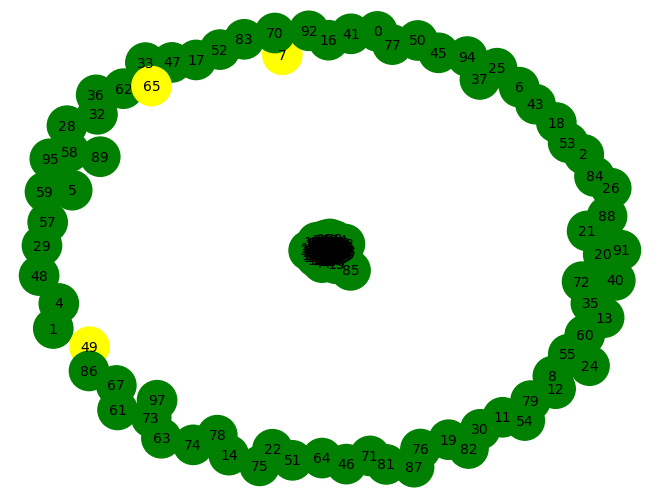

In [19]:
print("problem size", instance.size)
print("fire starts", instance.problem.fire_starts)
print("num teams", instance.problem.num_teams)
draw_graph(instance.problem)

In [20]:
displayer = Displayer()
gene_displayer = GeneEvolutionRenderer()

## The Run

In [21]:
data = optimize_and_collect(instance)

[2025-02-09 19:07:09][  0]     0.07107663     0.07101750 {37400.00000000 37426.40000000 37800.00000000  68.86973210}
[2025-02-09 19:07:09][  1]     0.15232253     0.07518911 {37400.00000000 37426.40000000 37800.00000000  71.15504199}
[2025-02-09 19:07:09][  2]     0.22199082     0.05780721 {37400.00000000 37424.40000000 37800.00000000  70.17577930}
[2025-02-09 19:07:09][  3]     0.27835536     0.05510783 {37400.00000000 37430.00000000 37800.00000000  72.52585746}
[2025-02-09 19:07:09][  4]     0.33709335     0.05719924 {37400.00000000 37432.80000000 37800.00000000  80.27552554}
[2025-02-09 19:07:09][  5]     0.39432168     0.05596828 {37400.00000000 37425.20000000 37800.00000000  68.73834447}
[2025-02-09 19:07:09][  6]     0.44793010     0.05242157 {37400.00000000 37430.80000000 37800.00000000  77.53296073}
[2025-02-09 19:07:09][  7]     0.50478435     0.05567169 {37400.00000000 37426.40000000 37600.00000000  67.69815359}
[2025-02-09 19:07:09][  8]     0.56011724     0.05390549 {37400.

In [22]:
solutions = correct_solutions(instance)

## Results

In [23]:
best_solution, best_solutions_value = max(solutions, key=lambda x: x[1])
print(f"Best solution [{best_solutions_value}]:\n{best_solution}")

Best solution [190]:
[7, 49, 51, 58, 65, 85, 131, 134, 155, 196]


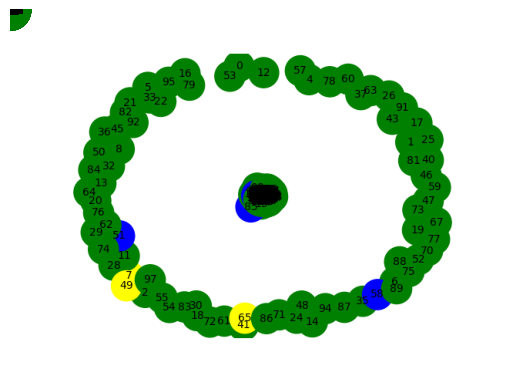

In [24]:
instance.problem.visualize_fire_without_burned(displayer, best_solution)

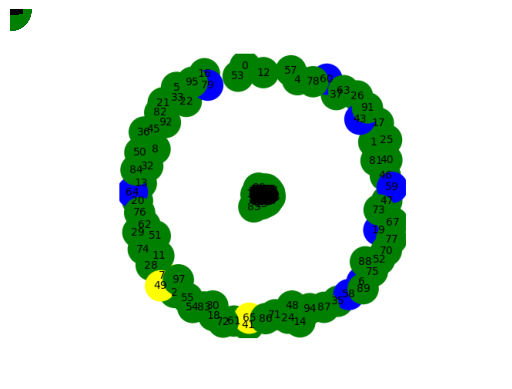

In [25]:
instance.problem.visualize_fires(displayer, solutions)

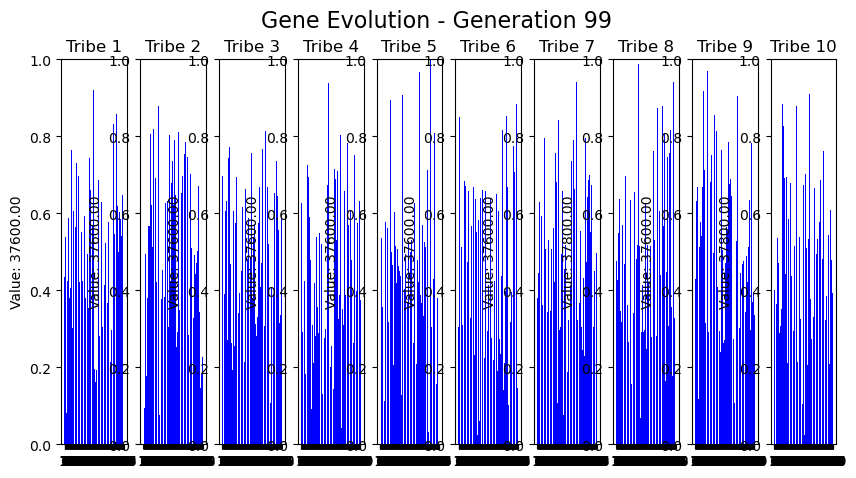

In [26]:
gene_displayer.visualize(data)

## Instance 200

[autoreload of Evaluators failed: Traceback (most recent call last):
  File "/opt/Anaconda3/anaconda3/lib/python3.12/site-packages/IPython/extensions/autoreload.py", line 276, in check
    superreload(m, reload, self.old_objects)
  File "/opt/Anaconda3/anaconda3/lib/python3.12/site-packages/IPython/extensions/autoreload.py", line 475, in superreload
    module = reload(module)
             ^^^^^^^^^^^^^^
  File "/opt/Anaconda3/anaconda3/lib/python3.12/importlib/__init__.py", line 131, in reload
    _bootstrap._exec(spec, module)
  File "<frozen importlib._bootstrap>", line 866, in _exec
  File "<frozen importlib._bootstrap_external>", line 991, in exec_module
  File "<frozen importlib._bootstrap_external>", line 1129, in get_code
  File "<frozen importlib._bootstrap_external>", line 1059, in source_to_code
  File "<frozen importlib._bootstrap>", line 488, in _call_with_frames_removed
  File "/media/foxinio/work/foxinio-work/Evo/project/repo/Evaluators.py", line 45
    def __call__(self

data collected


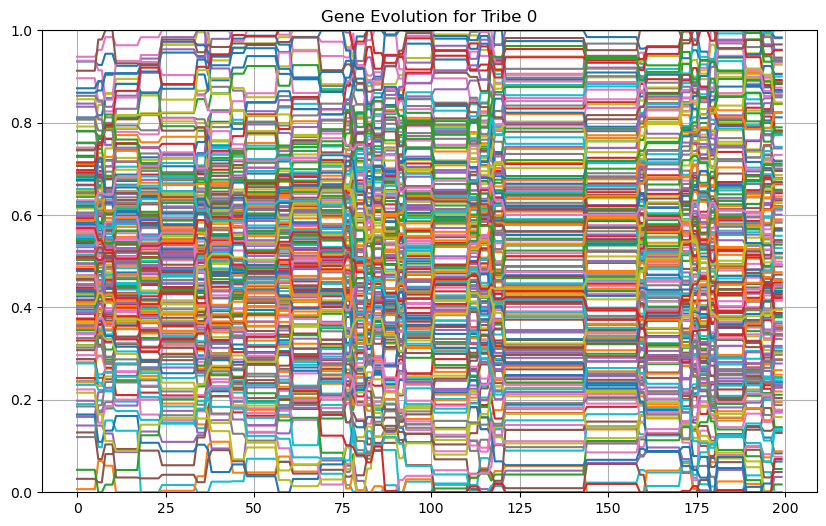

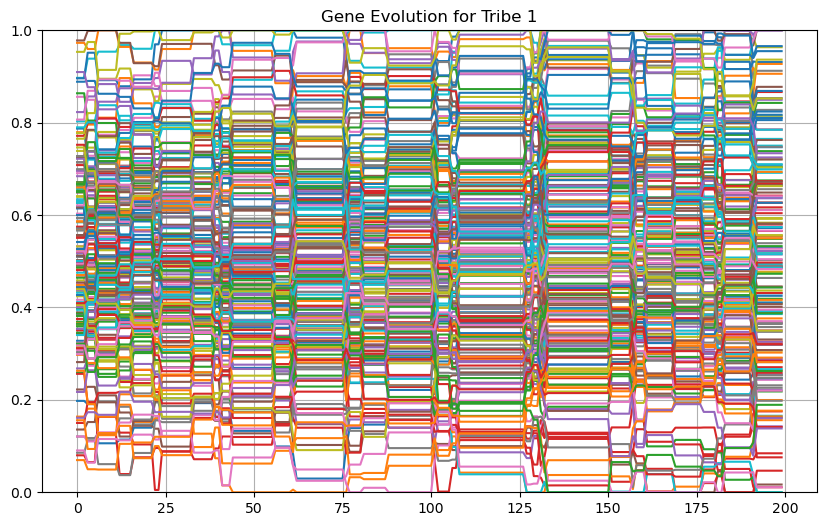

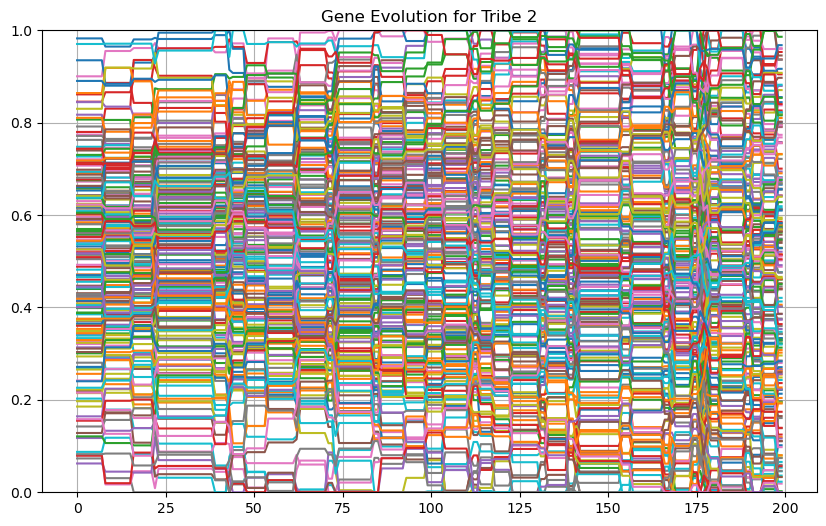

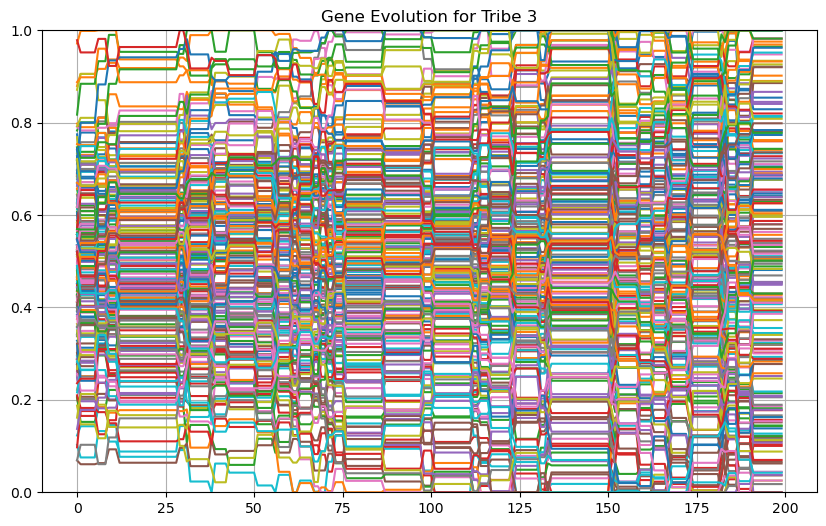

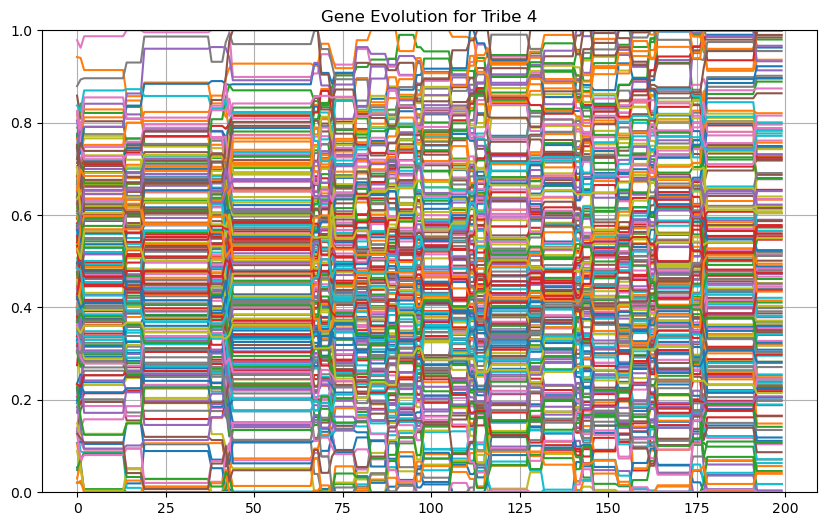

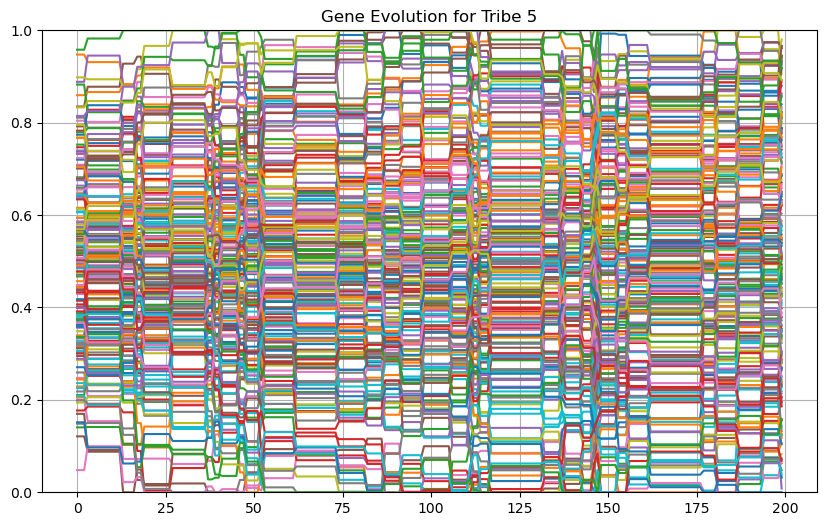

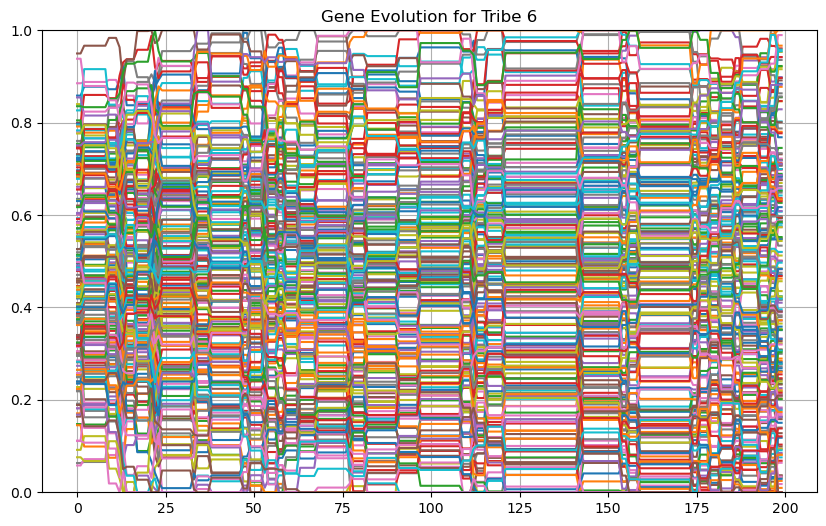

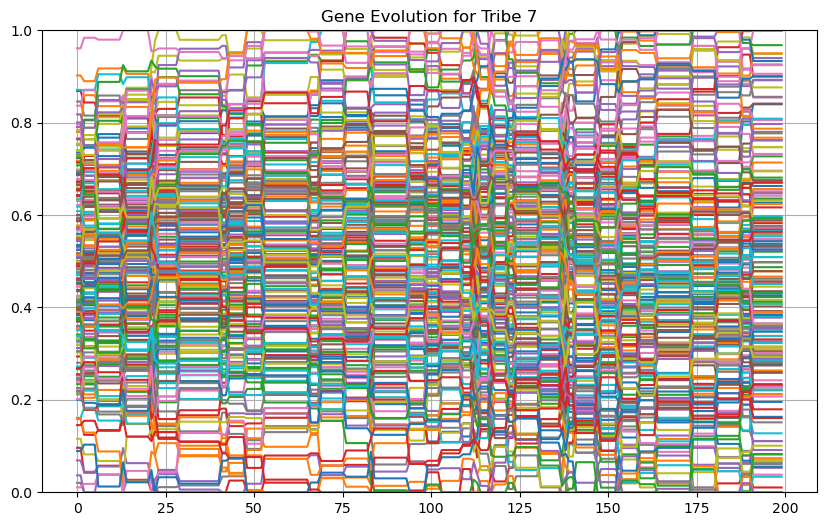

In [27]:
data200, instance200 = collect_and_visualize("../problems/p7.json", local_step_size=0.03, sigma=0.04)

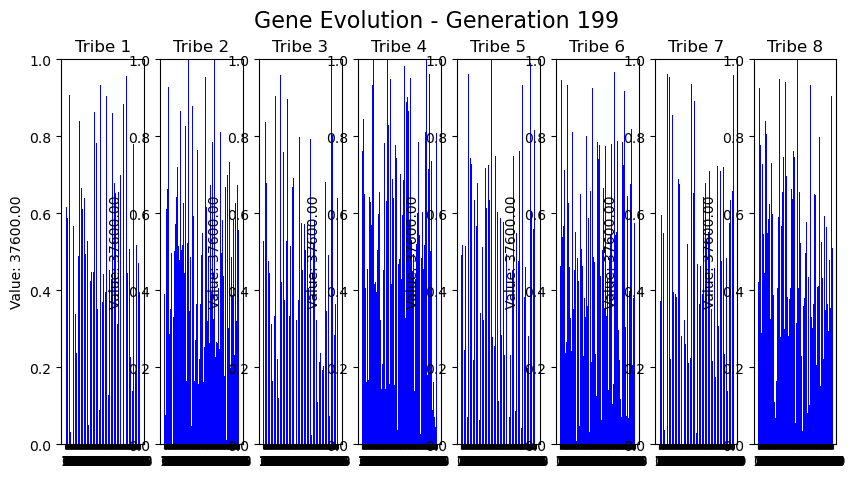

In [28]:
gene_displayer.visualize(data200)

In [29]:
solutions = correct_solutions(instance200)

In [30]:
best_solution_200, best_solutions_value_200 = max(solutions, key=lambda x: x[1])
print(f"Best solution [{best_solutions_value_200}]:\n{best_solution_200}")

Best solution [190]:
[7, 9, 49, 65, 69, 110, 111, 174, 177, 194]
